# Proyecto - Tel341: Simulación de Redes 2024-1
## Proveer de seguridad a redes empresariales de ataques.

### Integrantes:
- Vicente Olmos
- Pedro Arce
- Benjamin Espinoza
- Pablo Etcheberry

In [1]:
import json
from concurrent.futures import ThreadPoolExecutor
import time
from matplotlib import pyplot as plt
import datetime
import random
import pandas as pd


In [2]:
def load_attack_summary(filename):
    with open(filename, "r") as file:
        return json.load(file)


def plot_all_comparisons(attack_summaries, config_labels, num_iterations):
    rounds = list(range(1, num_iterations + 1))
    
    line_styles = ['-', '--', '-.', ':']
    markers = ['o', 's', 'D', '^', 'v', 'p', '*', 'h', '+', 'x']
    colors = plt.cm.get_cmap('tab10', len(config_labels))

    for metric, title, ylabel in [
        ('successful_requests', 'Solicitudes Exitosas', 'Cantidad'),
        ('blocked_requests', 'Solicitudes Bloqueadas', 'Cantidad'),
        ('blocked_by_ip', 'Solicitudes Bloqueadas por IP', 'Cantidad'),
        ('blocked_by_capacity', 'Solicitudes Bloqueadas por Capacidad', 'Cantidad'),
        ('blocked_by_segment', 'Solicitudes Bloqueadas por Segmento', 'Cantidad'),
        ('successful_attackers', 'Atacantes Exitosos', 'Cantidad'),
        ('blocked_attackers', 'Ataques Bloqueados ', 'Cantidad'),
        ('attack_duration_seconds', 'Duración del Ataque', 'Duración (segundos)'),
        ('extraction_percentage', 'Porcentaje de Extracción de Datos', 'Porcentaje (%)'),
        ('firewall_recovery_time_seconds', 'Tiempo Total de Recuperación del Firewall', 'Tiempo (segundos)')
    ]:
        fig, ax = plt.subplots(figsize=(12, 6))
        for i, label in enumerate(config_labels):
            data = [summary.get(metric, 0) for summary in attack_summaries[i]]
            
            if len(data) < num_iterations:
                data += [0] * (num_iterations - len(data))
            
            ax.plot(
                rounds,
                data,
                marker=markers[i % len(markers)],
                linestyle=line_styles[i % len(line_styles)],
                color=colors(i),
                label=label
            )

        ax.set_title(f"{title} (Iteraciones: {num_iterations})")
        ax.set_xlabel('Rondas')
        ax.set_ylabel(ylabel)
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.tight_layout()
        plt.show()

def plot_comparison(data, title, ylabel, labels, rounds, extra_info):
    fig, ax = plt.subplots()
    for i, d in enumerate(data):
        ax.plot(rounds, d, marker='o', label=labels[i])
    ax.set_xlabel('Rounds')
    ax.set_ylabel(ylabel)
    ax.set_title(f'{title} {extra_info}')
    ax.legend()
    plt.show()

In [3]:
def generate_comparison_table(attack_summaries, config_labels):
    table_data = []

    for i, label in enumerate(config_labels):
        for round_idx, summary in enumerate(attack_summaries[i]):
            row = [label, round_idx + 1]
            row.append(summary['total_requests'])
            row.append(summary['successful_requests'])
            row.append(summary['blocked_requests'])
            row.append(summary['blocked_by_ip'])
            row.append(summary['blocked_by_capacity'])
            row.append(summary['blocked_by_segment'])
            row.append(summary['successful_attackers'])
            row.append(summary['blocked_attackers'])
            row.append(summary['attack_duration_seconds'])
            row.append(summary['extraction_percentage'])
            row.append(summary['firewall_recovery_time_seconds'])
            table_data.append(row)

    headers = [
    'Configuración', 'Ronda', 'Solicitudes Totales', 'Solicitudes Exitosas', 'Solicitudes Bloqueadas',
    'Bloqueadas por IP', 'Bloqueadas por Capacidad', 'Bloqueadas por Segmento',
    'Atacantes Exitosos', 'Atacantes Bloqueados', 'Duración del Ataque (segundos)', 'Porcentaje de Extracción (%)', 'Tiempo de Recuperación del Firewall (segundos)'
]


    df = pd.DataFrame(table_data, columns=headers)
    df.to_csv('comparisons.csv', index=False)
    return df

In [4]:
class NetworkDevice:
    def __init__(self, ip_address):
        self.ip_address = ip_address
        self.connected_devices = []
        
    def connect_device(self, device):
        self.connected_devices.append(device)

    def display_connections(self):
        for device in self.connected_devices:
            print(f"Conectado a {device.ip_address}")

In [5]:
class Switch(NetworkDevice):
    def __init__(self, ip_address, port_count):
        super().__init__(ip_address)
        self.port_count = port_count
        self.vlans = {}

    def configure_vlan(self, vlan_id, ports):
        for port in ports:
            self.vlans[port] = vlan_id
        print(f"VLAN {vlan_id} configurada en los puertos: {ports}")

    def forward_packet(self, packet):
        port = packet.get('port')
        vlan_id = packet.get('vlan_id')

        if vlan_id:
            if port in self.vlans and self.vlans[port] == vlan_id:
                #print(f"Reenviando paquete en VLAN {vlan_id} desde el puerto {port}")
                return True
            else:
                #print(f"Paquete en VLAN {vlan_id} descartado en el puerto {port}. No hay VLAN configurada o hay una incompatibilidad de VLAN.")
                return False
        else:
            #print("Reenviando paquete en red plana.")
            return True

In [6]:
class Firewall(NetworkDevice):
    def __init__(
        self,
        ip_address,
        rule_set,
        capacity,
        recovery_time,
        block_by_ip=False,
        block_by_segment=False,
        block_by_capacity=False,
        segment_threshold=50,
        capacity_threshold=0.9,
    ):
        super().__init__(ip_address)
        self.rule_set = rule_set
        self.capacity = capacity
        self.recovery_time = recovery_time
        self.active = True
        self.request_count = 0
        self.blocked_ips = set()
        self.ip_requests = {}
        self.executor = ThreadPoolExecutor(max_workers=1)
        self.block_by_segment = block_by_segment
        self.block_by_capacity = block_by_capacity
        self.segment_threshold = segment_threshold
        self.capacity_threshold = capacity_threshold
        self.block_by_ip = block_by_ip
        self.segment_requests = {}
        self.total_recovery_time = 0

    def get_network_segment(self, ip_address):
        return ".".join(ip_address.split(".")[:2])

    def process_request(self, ip_address):
        segment = self.get_network_segment(ip_address)
        if self.block_by_segment and segment in self.blocked_ips:
            #print(f"Segmento {segment} bloqueado ip {ip_address} funcion {self.get_network_segment(ip_address)} if {segment in self.blocked_ips}.")
            return False, "blocked_segment"

        if self.block_by_capacity and self.request_count > self.capacity * self.capacity_threshold:
            #print(f"Capacidad del firewall sobrepasada. capacidad: {self.capacity} request_count: {self.request_count} threshold: {self.capacity * self.capacity_threshold} .") 
            return False, "blocked_capacity"
        
        if self.request_count > self.capacity:
            self.active = False
            self.executor.submit(self.recover)
            return True, "capacity"

        

        if self.block_by_segment:
            if segment in self.segment_requests:
                #print(f"Segmento {segment} ha sido solicitado {self.segment_requests[segment]} veces.")
                self.segment_requests[segment] += 1
            else:
                self.segment_requests[segment] = 1

            if self.segment_requests[segment] > self.segment_threshold:
                self.block_segment(segment)
                #print(f"El segmento {segment} ha sido bloqueado por exceso de solicitudes.")
                return False, "blocked_segment"

        if self.block_by_ip:
            if ip_address in self.blocked_ips:
                return False, "blocked"
            if ip_address in self.ip_requests:
                self.ip_requests[ip_address] += 1
            else:
                self.ip_requests[ip_address] = 1

            if self.ip_requests[ip_address] > 50:
                self.block_ip(ip_address)
                #print(f"La IP {ip_address} ha sido bloqueada por exceso de solicitudes.")
                return False, "blocked"

        self.request_count += 1
        return True, None

    def block_ip(self, ip_address):
        self.blocked_ips.add(ip_address)

    def block_segment(self, segment):
        self.blocked_ips.add(segment)

    def recover(self):
        start_recovery = datetime.datetime.now()
        time.sleep(self.recovery_time)
        self.total_recovery_time += (
            datetime.datetime.now() - start_recovery
        ).total_seconds()
        self.active = True
        self.request_count = 0
        # print("Firewall reactivado.")

In [7]:
class Router(NetworkDevice):
    def __init__(self, ip_address):
        super().__init__(ip_address)
        self.routing_table = {}

    def add_route(self, network, gateway):
        self.routing_table[network] = gateway
        #print(f"Ruta añadida: {network} vía {gateway}")

    def route_packet(self, packet):
        destination_ip = packet['destination_ip']
        source_ip = packet['source_ip']
        #print(f"Enrutando paquete de {source_ip} a {destination_ip}")

        dest_network = self.find_network(destination_ip)
        src_network = self.find_network(source_ip)
        
        #print(f"Red de destino: {dest_network}, Red de origen: {src_network}")
        #print("Tabla de enrutamiento:", self.routing_table)

        if dest_network and src_network:
            if dest_network == src_network:
                print(f"Enrutando paquete dentro de la misma subred a {destination_ip}")
            else:
                print(f"Enrutando paquete de {src_network} a {dest_network} vía {self.routing_table[dest_network]}")
        else:
            print(f"Paquete descartado. No hay ruta para {destination_ip}")

    def find_network(self, ip_address):
        network_part = '.'.join(ip_address.split('.')[:3])
        #print(f"Parte de la red: {network_part}")
        return next((network for network in self.routing_table if network.startswith(network_part)), None)

In [8]:
import datetime
import json


class Computer(NetworkDevice):
    def __init__(self, ip_address, mac_address, sensitive_data, file_size):
        super().__init__(ip_address)
        self.mac_address = mac_address
        self.sensitive_data = sensitive_data 
        self.file_size = file_size 
        self.file_events = []


    def send_data(self, data, destination_ip):
        packet = {'data': data, 'destination_ip': destination_ip, 'source_ip': self.ip_address}
        #print(f"{self.ip_address} enviando datos a {destination_ip}")
        return packet
    
    def access_file(self, user_ip, operation="read"):
        event = {
            "timestamp": datetime.datetime.now().isoformat(),
            "user_ip": user_ip,
            "operation": operation
        }
        self.file_events.append(event)

    def save_file_events(self):
        with open(f'{self.ip_address}_file_events.json', 'w') as f:
            json.dump(self.file_events, f, indent=4)

    

In [9]:
class Network:
    def __init__(self, upload_speed, download_speed, company_size):
        self.devices = []
        self.router = None
        self.firewall = None
        self.upload_speed = upload_speed
        self.download_speed = download_speed
        self.company_size = company_size
        self.has_firewall = False

    def add_switch(self, switch, pcs):
        self.devices.append(switch)
        self.devices.extend(pcs)

    def set_router(self, router):
        self.router = router
        self.devices.append(router)

    def set_firewall(self, firewall):
        self.firewall = firewall
        self.has_firewall = True
        self.devices.append(firewall)

    def list_devices(self):
        print("Dispositivos en la red:")
        for device in self.devices:
            if isinstance(device, Computer):
                print(
                    f"PC IP: {device.ip_address}, MAC: {device.mac_address}, File Size: {device.file_size}"
                )
            elif isinstance(device, Switch):
                print(
                    f"Switch IP: {device.ip_address}, Ports: {device.port_count}, VLANs: {device.vlans}"
                )
            elif isinstance(device, Router):
                print(
                    f"Router IP: {device.ip_address}, Routing Table: {device.routing_table}"
                )
            elif isinstance(device, Firewall):
                print(f"Firewall IP: {device.ip_address}, Rules: {device.rule_set}")
            else:
                print(f"Device IP: {device.ip_address}")

    def create_network(self, total_pcs, initial_switch_ip, vlan_ids=None):
        num_switches = 1 if self.company_size == "small" else (total_pcs + 47) // 48
        pcs_per_switch = total_pcs if self.company_size == "small" else 48
        current_ip = 100
        all_switches = []
        all_pcs = []

        for i in range(num_switches):
            switch_ip = f"{initial_switch_ip.rsplit('.', 1)[0]}.{i+1}"
            switch = Switch(switch_ip, 24)
            pcs = []
            vlan_id = (
                vlan_ids[i] if vlan_ids and i < len(vlan_ids) else (10 + i)
            )
            for j in range(min(pcs_per_switch, total_pcs)):
                pc_ip = f"{switch_ip.rsplit('.', 1)[0]}.{current_ip + j}"
                pc = Computer(
                    pc_ip,
                    f"00:1B:44:11:3A:{current_ip + j:02X}",
                    f"Sensitive data {current_ip + j}",
                    20000,
                )
                pcs.append(pc)
                switch.connect_device(pc)
            if self.company_size == "medium" or vlan_ids:
                switch.configure_vlan(
                    vlan_id, [j + 1 for j in range(min(pcs_per_switch, total_pcs))]
                )

            self.add_switch(switch, pcs)
            all_switches.append(switch)
            all_pcs.extend(pcs)

            total_pcs -= pcs_per_switch
            current_ip += pcs_per_switch
            if total_pcs <= 0:
                break

        self.configure_router()
        return all_switches, all_pcs

    def configure_router(self):
        if not self.router:
            raise ValueError("Router not set")
        for switch in self.devices:
            if isinstance(switch, Switch):
                for vlan_id in switch.vlans:
                    network = f"{switch.ip_address.rsplit('.', 1)[0]}.{vlan_id}0/24"
                    self.router.add_route(network, switch.ip_address)
                    print(
                        f"Añadiendo ruta al router: {network} via {switch.ip_address}"
                    )

    def process_request(self, ip_address, attack):
        time.sleep(random.uniform(0.1, 0.5))
        if self.firewall:
            allowed, reason = self.firewall.process_request(ip_address)
            if not allowed:
                if reason == "blocked" or reason == "blocked_segment" or reason == "blocked_capacity":
                    return False, reason
            if allowed and reason == "capacity":
                attack.access_data(self, ip_address)
                return True, reason
        attack.access_data(self, ip_address)
        return True, None


    def summarize_network_status(self):
        if self.has_firewall:
            print("La red tiene un firewall configurado.")
        else:
            print("La red no tiene firewall configurado.")

    def load_attack_data(self, filename):
        try:
            with open(filename, "r") as f:
                attack_data = json.load(f)
            return attack_data
        except FileNotFoundError:
            print("Archivo de resumen de ataque no encontrado")
            return {}

    def configure_firewall_rules(self, attack_summary, block_by_segment=False):
        if "attackers" in attack_summary:
            for ip, data in attack_summary["attackers"].items():
                if block_by_segment:
                    segment = self.firewall.get_network_segment(ip)
                    if segment not in self.firewall.blocked_ips:
                        self.firewall.block_segment(segment)
                        print(f"Segmento {segment} bloqueado basado en el resumen del ataque.")
                else:
                    if ip not in self.firewall.blocked_ips:
                        self.firewall.block_ip(ip)
                        print(f"IP {ip} bloqueada basado en el resumen del ataque.")


In [10]:
class DDoSAttack:
    def __init__(
        self, num_attackers, requests_per_attacker, base_ips, previous_attack_ips=None
    ):
        self.num_attackers = num_attackers
        self.requests_per_attacker = requests_per_attacker
        self.base_ips = base_ips
        self.extracted_data = {}
        self.total_data_extracted = 0.0
        self.full_extraction_ips = {}
        self.attack_start_time = None
        self.total_requests = 0
        self.blocked_requests = 0
        self.blocked_by_ip = 0
        self.blocked_by_capacity = 0
        self.blocked_by_segment = 0
        self.successful_requests = 0

        self.successful_attackers = 0
        self.blocked_ips = set()
        self.previous_attack_ips = previous_attack_ips if previous_attack_ips else set()
        self.attacker_request_counts = {}
        self.all_used_ips = set(
            self.previous_attack_ips
        )

    def generate_attacker_ips(self):
        attacker_ips = list(
            self.previous_attack_ips
        )
        base_ip = random.choice(self.base_ips)
        base_parts = base_ip.split(".")
        for i in range(1, 256):
            attacker_ip = f"{base_parts[0]}.{base_parts[1]}.{base_parts[2]}.{i}"
            if attacker_ip not in self.all_used_ips:
                attacker_ips.append(attacker_ip)
                self.all_used_ips.add(attacker_ip)
            if len(attacker_ips) >= self.num_attackers:
                break

        print(f"IPs de atacantes generadas: {attacker_ips}")
        return attacker_ips

    def launch_attack(self, network, label, iteration):
        print("Iniciando ataque DDoS...")
        self.attack_start_time = datetime.datetime.now()

        attacker_ips = self.generate_attacker_ips()
        self.previous_attack_ips.update(attacker_ips)

        with ThreadPoolExecutor(max_workers=self.num_attackers) as executor:
            futures = [
                executor.submit(self.simulate_attacker, network, ip)
                for ip in attacker_ips
            ]
            for future in futures:
                future.result()

        self.successful_attackers = len(self.full_extraction_ips)
        return self.summarize_attack(network, label, iteration)

    def simulate_attacker(self, network, ip_address):
        request_count = 0
        successful_requests = 0
        while request_count < self.requests_per_attacker:
            request_count += 1
            self.total_requests += 1
            allowed, reason = network.process_request(ip_address, self)
            print(
                f"IP: {ip_address}, Solicitud: {request_count}, Permitida: {allowed} ({reason}) solicitudes exitosas: {successful_requests}"
            )

            if allowed:
                successful_requests += 1
                self.access_data(network, ip_address)
            else:
                self.blocked_requests += 1
                if reason == "blocked":
                    self.blocked_by_ip += 1
                elif reason == "blocked_segment":
                    self.blocked_by_segment += 1
                elif reason == "blocked_capacity":
                    self.blocked_by_capacity += 1

                if reason in ["blocked", "blocked_segment",'blocked_capacity']:
                    continue 

            if self.check_complete_extraction(network):
                break

            time.sleep(0.01)

        self.successful_requests += successful_requests
        self.attacker_request_counts[ip_address] = (
            successful_requests
        )

    def check_complete_extraction(self, network):
        total_possible_data = sum(
            pc.file_size for pc in network.devices if isinstance(pc, Computer)
        )
        return self.total_data_extracted >= total_possible_data

    def access_data(self, network, attacker_ip):
        for device in network.devices:
            if isinstance(device, Computer):
                remaining_data = device.file_size - self.extracted_data.get(
                    device.ip_address, 0
                )
                if remaining_data > 0:
                    data_to_extract = min(remaining_data, 1)
                    self.extracted_data[device.ip_address] = (
                        self.extracted_data.get(device.ip_address, 0) + data_to_extract
                    )
                    self.total_data_extracted += data_to_extract
                    if attacker_ip not in self.full_extraction_ips:
                        self.full_extraction_ips[attacker_ip] = 0
                    self.full_extraction_ips[attacker_ip] += data_to_extract
                    if self.extracted_data[device.ip_address] >= device.file_size:
                        print(
                            f"Extracción completa de {device.ip_address} por {attacker_ip}"
                        )

    def summarize_attack(self, network, label, iteration):
        total_files_size_mb = sum(
            device.file_size
            for device in network.devices
            if isinstance(device, Computer)
        )
        total_files_size_gb = total_files_size_mb / 1024
        total_data_extracted_gb = self.total_data_extracted / 1024

        attack_duration = datetime.datetime.now() - self.attack_start_time
        attack_duration_seconds = attack_duration.total_seconds()

        avg_requests = (
            sum(self.attacker_request_counts.values())
            / len(self.attacker_request_counts)
            if self.attacker_request_counts
            else 0
        )
        avg_blocked_requests = (
            self.blocked_requests / self.num_attackers if self.num_attackers > 0 else 0
        )
        firewall_recovery_time = (
            network.firewall.total_recovery_time if network.firewall else 0
        )
        total_successful_requests = sum(self.attacker_request_counts.values())

        attack_data = {
            "firewall_recovery_time_seconds": firewall_recovery_time,
            "successful_requests": total_successful_requests,
            "total_extracted_gb": total_data_extracted_gb,
            "total_available_gb": total_files_size_gb,
            "extraction_percentage": (
                (total_data_extracted_gb / total_files_size_gb * 100)
                if total_files_size_gb > 0
                else 0
            ),
            "attack_duration_seconds": attack_duration_seconds,
            "attacked_devices_count": len(self.extracted_data),
            "total_requests": self.total_requests,
            "blocked_requests": self.blocked_requests,
            "blocked_by_ip": self.blocked_by_ip,
            "blocked_by_capacity": self.blocked_by_capacity,
            "blocked_by_segment": self.blocked_by_segment,
            "total_attackers": self.num_attackers,
            "successful_attackers": self.successful_attackers,
            "blocked_attackers": self.num_attackers - self.successful_attackers,
            "average_requests_per_attacker": avg_requests,
            "average_blocked_requests_per_attacker": avg_blocked_requests,
            "attackers": {
                attacker_ip: {
                    "data_extracted_mb": self.full_extraction_ips.get(attacker_ip, 0),
                    "requests": self.attacker_request_counts.get(attacker_ip, 0),
                }
                for attacker_ip in self.attacker_request_counts
            },
        }

        attack_summary_file = f'attack_summary_{label}_iter_{iteration}_{datetime.datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
        with open(attack_summary_file, "w") as f:
            json.dump(attack_data, f, indent=4)

        print("Resumen del ataque DDoS:")
        print(
            f"Datos totales extraídos: {total_data_extracted_gb:.2f}GB de {total_files_size_gb:.2f}GB disponibles."
        )
        print(
            f"Porcentaje de datos extraídos: {(total_data_extracted_gb / total_files_size_gb * 100):.2f}%"
        )
        print(f"Duración del ataque: {attack_duration_seconds:.2f} segundos.")
        print(f"Dispositivos afectados: {len(self.extracted_data)}")
        print(f"Solicitudes totales: {self.total_requests}")
        print(f"Solicitudes bloqueadas: {self.blocked_requests}")
        print(f"Solicitudes bloqueadas por IP: {self.blocked_by_ip}")
        print(f"Solicitudes bloqueadas por capacidad: {self.blocked_by_capacity}")
        print(f"Solicitudes bloqueadas por segmento: {self.blocked_by_segment}")
        print(f"Total de atacantes: {self.num_attackers}")
        print(f"Atacantes exitosos: {self.successful_attackers}")
        print(f"Atacantes bloqueados: {self.blocked_by_ip + self.blocked_by_capacity + self.blocked_by_segment}")
        print(f"Media de solicitudes por atacante: {avg_requests:.2f}")
        print(
            f"Media de solicitudes bloqueadas por atacante: {avg_blocked_requests:.2f}"
        )

        if network.has_firewall:
            if network.firewall and not network.firewall.active:
                print("El firewall fue sobrepasado durante el ataque.")
            else:
                print("El firewall resistió el ataque sin ser sobrepasado.")
        else:
            print("La red no tiene firewall configurado.")

        return attack_summary_file

In [11]:
base_ips = [
    "10.6.0.0", "10.7.0.0", "10.8.0.0", "10.9.0.0", "10.10.0.0",
    "10.11.0.0", "10.12.0.0", "10.13.0.0", "10.14.0.0", "10.15.0.0",
    "10.16.0.0", "10.17.0.0", "10.18.0.0", "10.19.0.0", "10.20.0.0",
    "10.21.0.0", "10.22.0.0", "10.23.0.0", "10.24.0.0", "10.25.0.0",
    "10.26.0.0", "10.27.0.0", "10.28.0.0", "10.29.0.0", "10.30.0.0",
    "10.31.0.0", "10.32.0.0", "10.33.0.0", "10.34.0.0", "10.35.0.0",
    "10.36.0.0", "10.37.0.0", "10.38.0.0", "10.39.0.0", "10.40.0.0",
    "10.41.0.0", "10.42.0.0", "10.43.0.0", "10.44.0.0", "10.45.0.0",
    "10.46.0.0", "10.47.0.0", "10.48.0.0", "10.49.0.0", "10.50.0.0"
]


In [12]:
def setup_network():
    network = Network(upload_speed=100, download_speed=50, company_size='small')
    router = Router("192.168.1.1")
    network.set_router(router)

    switch, pcs = network.create_network(5, "192.168.10.1", vlan_ids=[10])
    network.configure_router()

    another_switch, more_pcs = network.create_network(3, "192.168.20.1", vlan_ids=[20])
    network.configure_router()

    network.list_devices()
    network.summarize_network_status()
    
    return network



In [13]:
config_labels = [
    "Sin Firewall",
    "Firewall con Bloqueo por IP sin ataque previo",
    "Firewall con Bloqueo por IP con ataque previo",
    "Firewall con Bloqueo por Segmento sin ataque previo",
    "Firewall con Bloqueo por Segmento con ataque previo",
    "Firewall con Bloqueo por Capacidad",
    "Firewall con Bloqueo por IP, Segmento y Capacidad con ataque previo",
]


capacidad = 1000


def run_simulation(
    attack_summaries, label, firewall=None, update_previous_ips=True, num_iterations=1
):
    initial_attackers = 30
    previous_attack_ips = set()
    network = setup_network()
    summary_files = []

    if firewall:
        network.set_firewall(firewall)
        
    for attack_round in range(num_iterations):
        print(
            f"Iniciando ataque DDoS ronda {attack_round + 1} para configuración {label}..."
        )
        if firewall:
            print(f"blocked {firewall.blocked_ips}")
            firewall.request_count = 0

        ddos_attack = DDoSAttack(
            num_attackers=initial_attackers,
            requests_per_attacker=150,
            base_ips=base_ips,
            previous_attack_ips=previous_attack_ips,
        )
        attack_summary_file = ddos_attack.launch_attack(
            network, label, attack_round + 1
        )

        summary_files.append(attack_summary_file)
        attack_summary = load_attack_summary(attack_summary_file)
        attack_summaries[config_labels.index(label)].append(attack_summary)

        if update_previous_ips and firewall:
            previous_attack_ips.update(ddos_attack.all_used_ips)
            for summary_file in summary_files:
                attack_summary = load_attack_summary(summary_file)
                network.configure_firewall_rules(
                    attack_summary, block_by_segment=firewall.block_by_segment
                )

        initial_attackers = int(initial_attackers * 1.5)


firewall_configs = [
    (
        config_labels[1],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=True,
            block_by_segment=False,
            block_by_capacity=False,
        ),
        False,
    ),
    (
        config_labels[2],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=True,
            block_by_segment=False,
            block_by_capacity=False,
        ),
        True,
    ),
    (
        config_labels[3],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=False,
            block_by_segment=True,
            block_by_capacity=False,
            segment_threshold=80,
        ),
        False,
    ),
    (
        config_labels[4],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=False,
            block_by_segment=True,
            block_by_capacity=False,
            segment_threshold=80,
        ),
        True,
    ),
    (
        config_labels[5],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=False,
            block_by_segment=False,
            block_by_capacity=True,
            capacity_threshold=0.6,
        ),
        False,
    ),
    (
        config_labels[6],
        Firewall(
            "192.168.1.254",
            {"default": "allow"},
            capacidad,
            10,
            block_by_ip=True,
            block_by_segment=True,
            block_by_capacity=True,
            capacity_threshold=0.6,
            segment_threshold=80,
        ),
        False,
    ),
]

In [14]:
attack_summaries = [[] for _ in config_labels]

run_simulation(attack_summaries, config_labels[0], firewall=None, update_previous_ips=False, num_iterations=3)

for label, firewall, update_previous_ips in firewall_configs:
    run_simulation(attack_summaries, label, firewall, update_previous_ips, num_iterations=3)

VLAN 10 configurada en los puertos: [1, 2, 3, 4, 5]
Ruta añadida: 192.168.10.10/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.10/24 via 192.168.10.1
Ruta añadida: 192.168.10.20/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.20/24 via 192.168.10.1
Ruta añadida: 192.168.10.30/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.30/24 via 192.168.10.1
Ruta añadida: 192.168.10.40/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.40/24 via 192.168.10.1
Ruta añadida: 192.168.10.50/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.50/24 via 192.168.10.1
Ruta añadida: 192.168.10.10/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.10/24 via 192.168.10.1
Ruta añadida: 192.168.10.20/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.20/24 via 192.168.10.1
Ruta añadida: 192.168.10.30/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10.30/24 via 192.168.10.1
Ruta añadida: 192.168.10.40/24 vía 192.168.10.1
Añadiendo ruta al router: 192.168.10

In [15]:
comparison_table = generate_comparison_table(attack_summaries, config_labels)


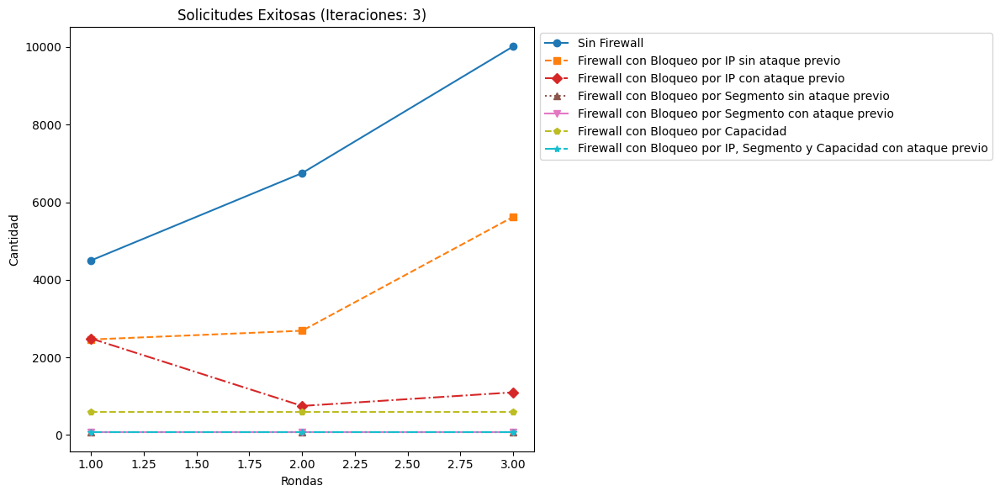

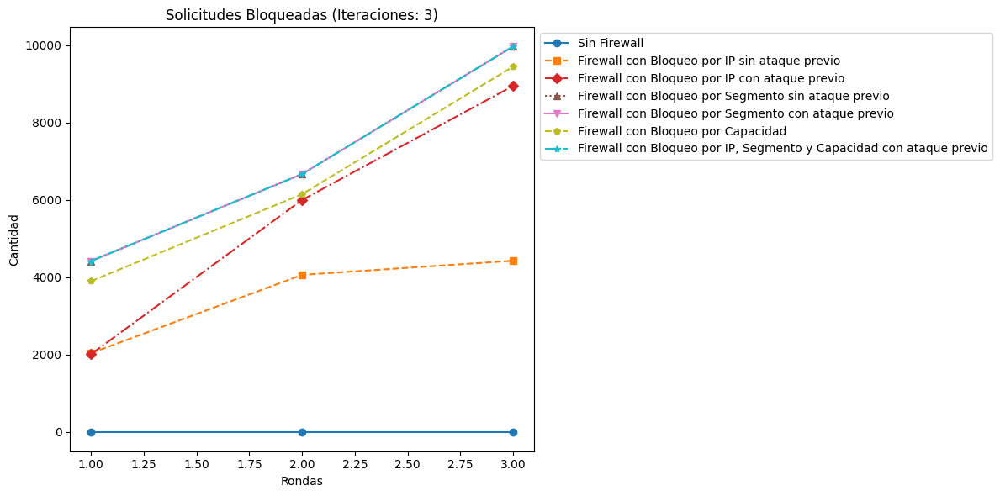

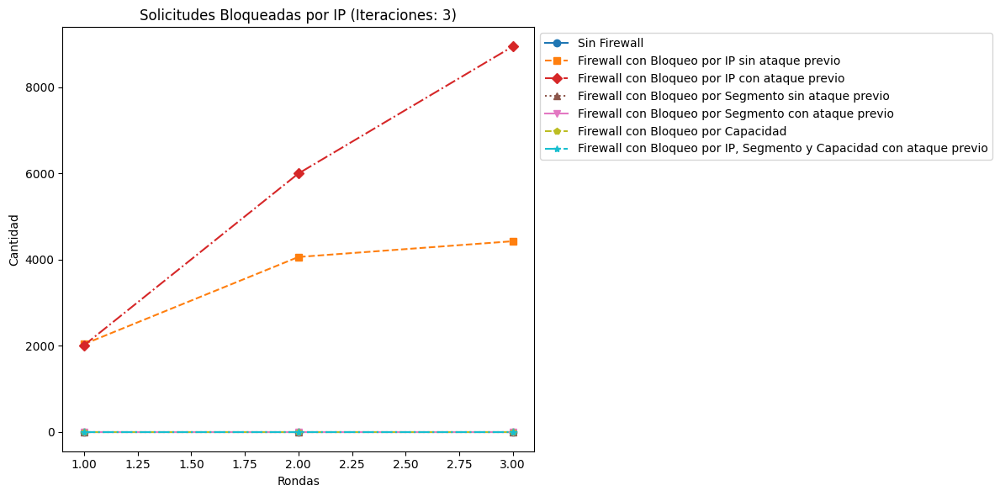

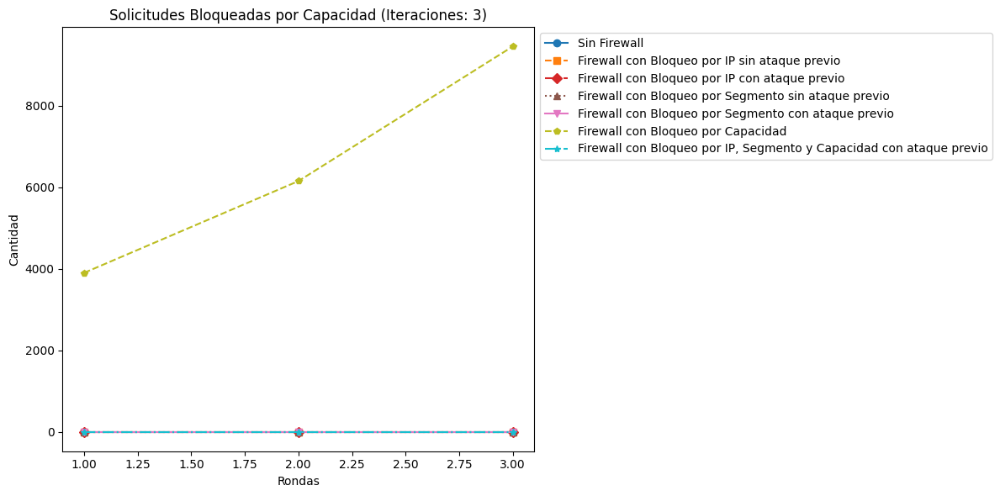

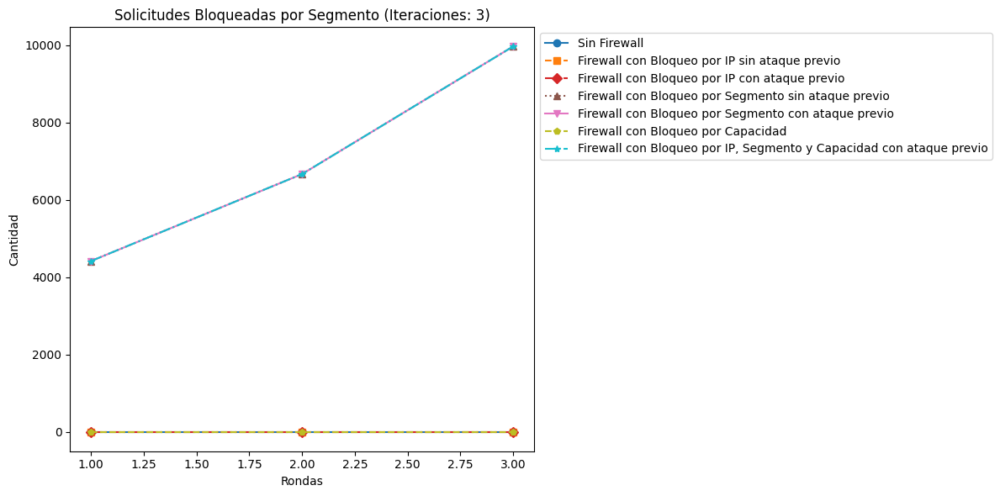

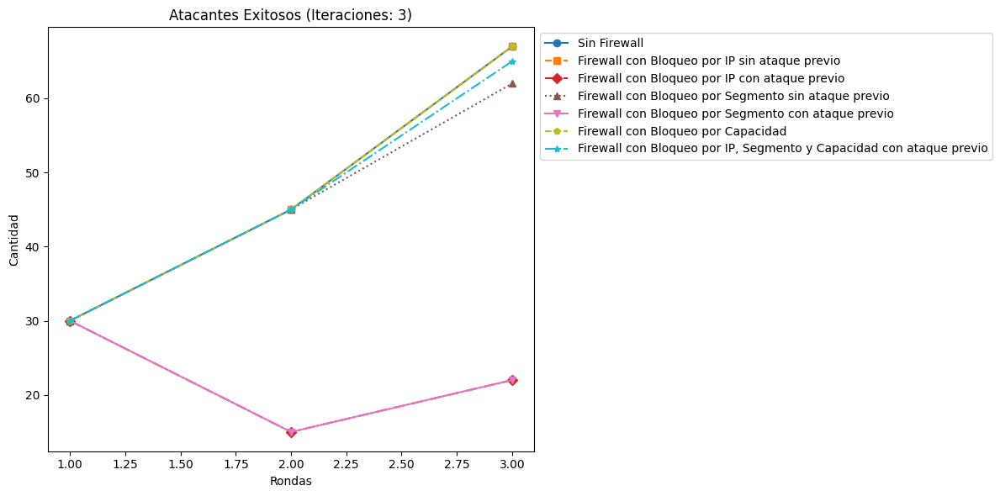

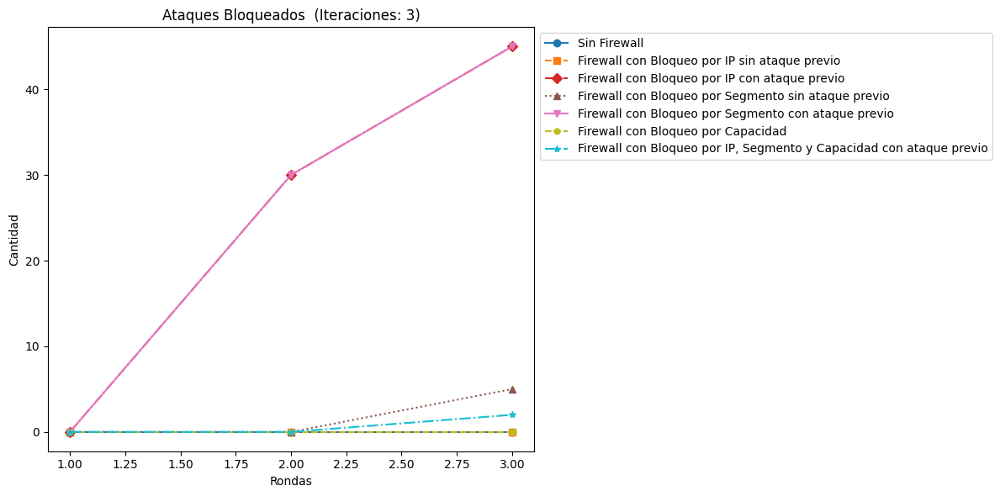

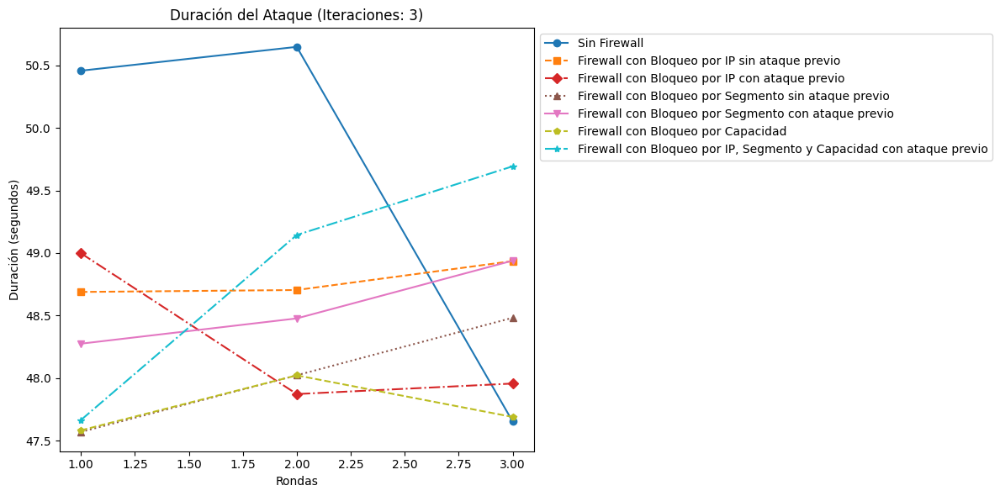

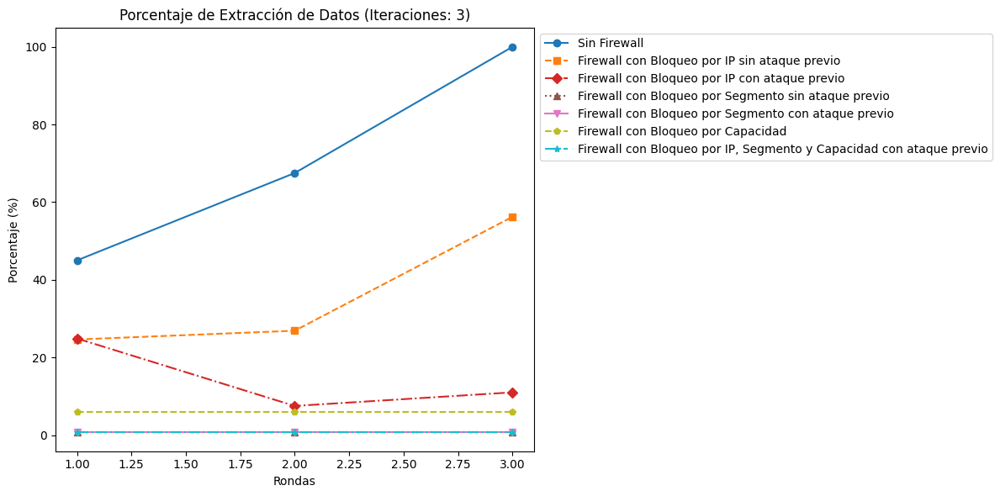

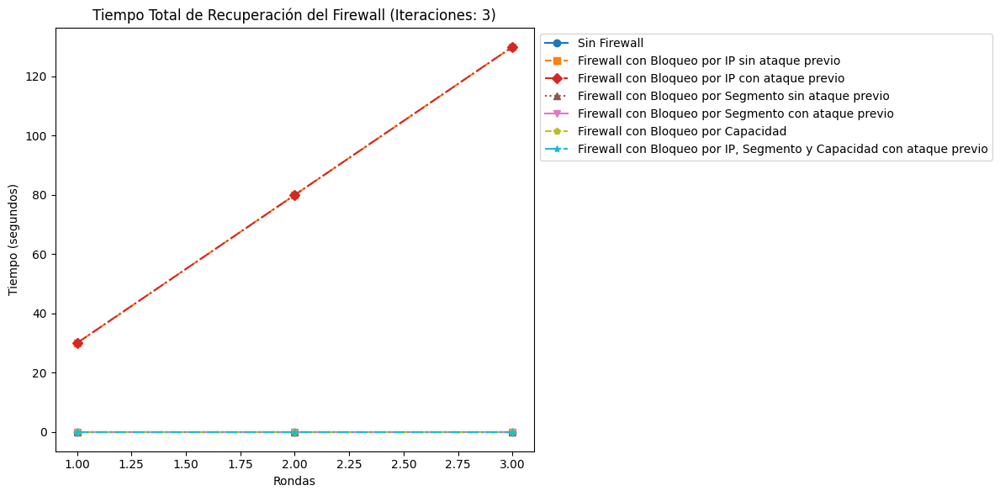

In [16]:
plot_all_comparisons(attack_summaries, config_labels, num_iterations=3)